# Configure Merge Module Params

This notebook should be used as a test for ensuring correct merge parameters before merge processing.
Cells marked with <font color='red'>SET PARAMETERS</font> contain crucial variables that need to be set according to your specific experimental setup and data organization.
Please review and modify these variables as needed before proceeding with the analysis.

## <font color='red'>SET PARAMETERS</font>

### Fixed parameters for merge processing

- `CONFIG_FILE_PATH`: Path to a Brieflow config file used during processing. Absolute or relative to where workflows are run from.

In [83]:
CONFIG_FILE_PATH = "config/config.yml"

In [84]:
import warnings
from pathlib import Path

import yaml
import pandas as pd

from lib.shared.file_utils import get_filename
from lib.shared.configuration_utils import (
    plot_combined_tile_grid,
    plot_merge_example,
    CONFIG_FILE_HEADER,
)
from lib.merge.hash import hash_cell_locations, initial_alignment
from lib.merge.eval_alignment import plot_alignment_quality

## <font color='red'>SET PARAMETERS</font>

### Determine merge plate-well combos
- `MERGE_COMBO_DF_FP`: Plate used for testing configuration

In [85]:
MERGE_COMBO_DF_FP = "config/merge_combo.tsv"

In [86]:
# load config file and determine root path
with open(CONFIG_FILE_PATH, "r") as config_file:
    config = yaml.safe_load(config_file)

SBS_COMBO_FP = Path(config["preprocess"]["sbs_combo_fp"])
sbs_wildcard_combos = pd.read_csv(SBS_COMBO_FP, sep="\t")
PHENOTYPE_COMBO_FP = Path(config["preprocess"]["phenotype_combo_fp"])
phenotype_wildcard_combos = pd.read_csv(PHENOTYPE_COMBO_FP, sep="\t")

# Generate plate-well combinations for merge
sbs_combos = set(zip(sbs_wildcard_combos["plate"], sbs_wildcard_combos["well"]))
phenotype_combos = set(
    zip(phenotype_wildcard_combos["plate"], phenotype_wildcard_combos["well"])
)
# Check if SBS and PHENOTYPE have the same plate-well combinations
if sbs_combos == phenotype_combos:
    merge_wildcard_combos = pd.DataFrame(list(sbs_combos), columns=["plate", "well"])
else:
    warnings.warn(
        "SBS and PHENOTYPE do not have matching plate-well combinations. Merging requires identical sets."
    )
    merge_wildcard_combos = pd.DataFrame(columns=["plate", "well"])

merge_wildcard_combos.to_csv(MERGE_COMBO_DF_FP, sep="\t", index=False)
merge_wildcard_combos

,plate,well
0,1,B1
1,1,B2


## <font color='red'>SET PARAMETERS</font>

### Parameters for testing merge module
- `TEST_PLATE`: Plate used for testing configuration 
- `TEST_WELL`: Well identifier used for testing configuration 

### Parameters for metadata extraction
- `SBS_METADATA_CYCLE`: Cycle number for extracting SBS data positions
- `SBS_METADATA_CHANNEL`: Optional channel for SBS metadata. This is necessary in the case that multiple channel-based images were acquired, and therefore, multiple channel-based metadata files exist.
- `PH_METADATA_CHANNEL`: Optional channel for phenotype metadata. This is necessary in the case that multiple channel-based images were acquired, and therefore, multiple channel-based metadata files exist.

In [87]:
TEST_PLATE = 1
TEST_WELL = "B1"

SBS_METADATA_CYCLE = 1
SBS_METADATA_CHANNEL = None
PH_METADATA_CHANNEL = None

In [88]:
ROOT_FP = Path(config["all"]["root_fp"])

# load phenotype and SBS metadata dfs
ph_filename_params = {"plate": TEST_PLATE, "well": TEST_WELL}
if PH_METADATA_CHANNEL is not None:
    ph_filename_params["channel"] = PH_METADATA_CHANNEL

ph_test_metadata_fp = (
    ROOT_FP
    / "preprocess"
    / "metadata"
    / "phenotype"
    / get_filename(ph_filename_params, "combined_metadata", "parquet")
)
ph_test_metadata = pd.read_parquet(ph_test_metadata_fp)

# Apply phenotype channel filtering if specified, otherwise deduplicate
if PH_METADATA_CHANNEL is not None:
    ph_test_metadata = ph_test_metadata[ph_test_metadata["channel"] == PH_METADATA_CHANNEL]
else:
    ph_test_metadata = ph_test_metadata.drop_duplicates(subset=["plate", "well", "tile"])

sbs_filename_params = {"plate": TEST_PLATE, "well": TEST_WELL}
if SBS_METADATA_CHANNEL is not None:
    sbs_filename_params["channel"] = SBS_METADATA_CHANNEL

sbs_test_metadata_fp = (
    ROOT_FP
    / "preprocess"
    / "metadata"
    / "sbs"
    / get_filename(sbs_filename_params, "combined_metadata", "parquet")
)
sbs_test_metadata = pd.read_parquet(sbs_test_metadata_fp)

# Apply SBS filtering - always filter by cycle, optionally by channel, otherwise deduplicate
sbs_test_metadata = sbs_test_metadata[sbs_test_metadata["cycle"] == SBS_METADATA_CYCLE]
if SBS_METADATA_CHANNEL is not None:
    sbs_test_metadata = sbs_test_metadata[sbs_test_metadata["channel"] == SBS_METADATA_CHANNEL]
else:
    # Only deduplicate if no channel filter was applied (cycle filter was already applied)
    sbs_test_metadata = sbs_test_metadata.drop_duplicates(subset=["plate", "well", "tile"])

In [89]:
# Derive phenotype alignment hash
phenotype_info_fp = (
    ROOT_FP
    / "phenotype"
    / "parquets"
    / get_filename(
        {"plate": TEST_PLATE, "well": TEST_WELL}, "phenotype_info", "parquet"
    )
)
phenotype_info = pd.read_parquet(phenotype_info_fp)

# Derive SBS alignment hash
sbs_info_fp = (
    ROOT_FP
    / "sbs"
    / "parquets"
    / get_filename({"plate": TEST_PLATE, "well": TEST_WELL}, "sbs_info", "parquet")
)
sbs_info = pd.read_parquet(sbs_info_fp)

In [90]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def plot_sbs_global_cell_positions(sbs_info, sbs_metadata):
    """
    Plot SBS cell positions (i,j) at their global tile locations (x_pos, y_pos).
    
    Args:
        sbs_info (pd.DataFrame): SBS info data with 'i', 'j', 'tile' columns (cell positions within tiles)
        sbs_metadata (pd.DataFrame): SBS metadata with 'x_pos', 'y_pos', 'tile' columns (tile positions)
    """
    # Merge info and metadata to get global positions
    merged = sbs_info.merge(sbs_metadata[['tile', 'x_pos', 'y_pos']], on='tile', how='left')
    
    # Calculate global cell positions
    # Add the tile position to the local cell position
    merged['global_i'] = merged['y_pos'] + merged['j']
    merged['global_j'] = -(merged['x_pos'] + merged['i'])
    
    # Create the plot
    fig, ax = plt.subplots(1, 1, figsize=(20, 16))
    
    # Plot all cells as small dots
    ax.scatter(merged['global_i'], merged['global_j'], 
               s=2, alpha=0.6, c='red', label=f'SBS Cells ({len(merged)} total)')
    
    # Overlay tile boundaries/centers
    for _, tile_row in sbs_metadata.iterrows():
        tile_id = tile_row['tile']
        x_pos = tile_row['x_pos']
        y_pos = tile_row['y_pos']
        
        # Get cells for this tile to determine tile size
        tile_cells = merged[merged['tile'] == tile_id]
        if len(tile_cells) > 0:
            # Estimate tile boundaries based on cell positions
            tile_i_min = tile_cells['i'].min()
            tile_i_max = tile_cells['i'].max()
            tile_j_min = tile_cells['j'].min()
            tile_j_max = tile_cells['j'].max()
            
            # Draw tile boundary rectangle
            rect_width = tile_i_max - tile_i_min
            rect_height = tile_j_max - tile_j_min
            
            from matplotlib.patches import Rectangle
            rect = Rectangle((x_pos + tile_i_min, y_pos + tile_j_min), 
                           rect_width, rect_height,
                           linewidth=2, edgecolor='blue', facecolor='none', alpha=0.7)
            ax.add_patch(rect)
            
            # Label tile center
            center_i = x_pos + (tile_i_min + tile_i_max) / 2
            center_j = y_pos + (tile_j_min + tile_j_max) / 2
            ax.annotate(f'Tile {tile_id}', (center_i, center_j),
                       ha='center', va='center', fontsize=10, 
                       bbox=dict(boxstyle="round,pad=0.3", facecolor='yellow', alpha=0.7))
    
    ax.set_title('SBS Global Cell Positions\n(Red dots = cells, Blue boxes = tile boundaries)', fontsize=16)
    ax.set_xlabel('Global i position', fontsize=14)
    ax.set_ylabel('Global j position', fontsize=14)
    ax.grid(True, alpha=0.3)
    ax.set_aspect('equal')
    ax.legend(fontsize=12)
    
    plt.tight_layout()
    plt.show()
    
    # Print summary
    print("=== SBS GLOBAL POSITIONING SUMMARY ===")
    print(f"Total cells: {len(merged)}")
    print(f"Total tiles: {len(sbs_metadata)}")
    print(f"Global coordinate range:")
    print(f"  i: {merged['global_i'].min():.0f} to {merged['global_i'].max():.0f}")
    print(f"  j: {merged['global_j'].min():.0f} to {merged['global_j'].max():.0f}")
    
    return merged


In [91]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def align_coordinates_flip_rotate(df1, df2, x_col='x_pos', y_col='y_pos', reference_df=1,
                                 flip_x=False, flip_y=False, rotate_90=False):
    """
    Align coordinates with flipping and rotation, then translation.
    
    Parameters:
    -----------
    df1, df2 : pandas.DataFrame
        DataFrames containing position data
    x_col, y_col : str
        Column names for x and y coordinates
    reference_df : int (1 or 2)
        Which dataframe to use as reference (the other will be transformed)
    flip_x : bool
        Whether to flip x coordinates (negate x values)
    flip_y : bool
        Whether to flip y coordinates (negate y values)
    rotate_90 : bool
        Whether to rotate 90 degrees counterclockwise
    
    Returns:
    --------
    df1_aligned, df2_aligned : pandas.DataFrame
        Aligned dataframes with modified coordinates
    transformation_info : dict
        Information about the transformation applied
    """
    
    df1_aligned = df1.copy()
    df2_aligned = df2.copy()
    
    # Calculate initial centers
    center1_orig = (df1[x_col].mean(), df1[y_col].mean())
    center2_orig = (df2[x_col].mean(), df2[y_col].mean())
    
    print(f"Original centers:")
    print(f"  Dataset 1: ({center1_orig[0]:.2f}, {center1_orig[1]:.2f})")
    print(f"  Dataset 2: ({center2_orig[0]:.2f}, {center2_orig[1]:.2f})")
    
    if reference_df == 1:
        # Transform df2 to match df1
        target_df = df2_aligned
        target_coords = df2[[x_col, y_col]].values
        reference_center = center1_orig
        print("\nTransforming dataset 2 to match dataset 1")
    else:
        # Transform df1 to match df2
        target_df = df1_aligned
        target_coords = df1[[x_col, y_col]].values
        reference_center = center2_orig
        print("\nTransforming dataset 1 to match dataset 2")
    
    # Get the center of the dataset being transformed
    transform_center = np.mean(target_coords, axis=0)
    
    # Step 1: Center the coordinates around origin
    centered_coords = target_coords - transform_center
    print(f"Step 1: Centered coordinates around ({transform_center[0]:.2f}, {transform_center[1]:.2f})")
    
    # Step 2: Flip coordinates if requested
    if flip_x:
        centered_coords[:, 0] = -centered_coords[:, 0]  # Flip x coordinates
        print(f"Step 2a: Flipped x coordinates")
    
    if flip_y:
        centered_coords[:, 1] = -centered_coords[:, 1]  # Flip y coordinates
        print(f"Step 2b: Flipped y coordinates")
    
    # Step 3: Rotate 90 degrees counterclockwise if requested
    if rotate_90:
        # 90-degree counterclockwise rotation matrix: [[0, -1], [1, 0]]
        # New x = -old y, New y = old x
        new_coords = np.zeros_like(centered_coords)
        new_coords[:, 0] = -centered_coords[:, 1]  # new x = -old y
        new_coords[:, 1] = centered_coords[:, 0]   # new y = old x
        centered_coords = new_coords
        print(f"Step 3: Rotated 90 degrees counterclockwise")
    
    # Step 4: Calculate translation to align centers
    transformed_center = np.mean(centered_coords, axis=0)
    translation = np.array(reference_center) - transformed_center
    
    # Step 5: Apply translation
    final_coords = centered_coords + translation
    
    print(f"Step 4: Applied translation: ({translation[0]:.2f}, {translation[1]:.2f})")
    
    # Update the target dataframe
    target_df[x_col] = final_coords[:, 0]
    target_df[y_col] = final_coords[:, 1]
    
    # Verify final centers
    if reference_df == 1:
        final_center1 = (df1_aligned[x_col].mean(), df1_aligned[y_col].mean())
        final_center2 = (df2_aligned[x_col].mean(), df2_aligned[y_col].mean())
    else:
        final_center1 = (df1_aligned[x_col].mean(), df1_aligned[y_col].mean())
        final_center2 = (df2_aligned[x_col].mean(), df2_aligned[y_col].mean())
    
    print(f"\nFinal centers:")
    print(f"  Dataset 1: ({final_center1[0]:.2f}, {final_center1[1]:.2f})")
    print(f"  Dataset 2: ({final_center2[0]:.2f}, {final_center2[1]:.2f})")
    
    transformation_info = {
        'flip_x': flip_x,
        'flip_y': flip_y,
        'rotate_90': rotate_90,
        'translation': translation,
        'reference_df': reference_df,
        'original_centers': (center1_orig, center2_orig),
        'final_centers': (final_center1, final_center2)
    }
    
    return df1_aligned, df2_aligned, transformation_info

def visualize_transformation_steps(df_original, x_col='x_pos', y_col='y_pos', 
                                  flip_x=False, flip_y=False, rotate_90=False):
    """
    Visualize each step of the transformation process.
    """
    coords = df_original[[x_col, y_col]].values
    center = np.mean(coords, axis=0)
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # Step 0: Original
    axes[0,0].scatter(coords[:, 0], coords[:, 1], alpha=0.6, s=20)
    axes[0,0].set_title('Original Coordinates')
    axes[0,0].set_aspect('equal')
    axes[0,0].grid(True, alpha=0.3)
    
    # Step 1: Centered
    centered = coords - center
    axes[0,1].scatter(centered[:, 0], centered[:, 1], alpha=0.6, s=20)
    axes[0,1].set_title('Step 1: Centered at Origin')
    axes[0,1].set_aspect('equal')
    axes[0,1].grid(True, alpha=0.3)
    
    # Step 2: Flipped
    flipped = centered.copy()
    flip_title = "Step 2: "
    if flip_x:
        flipped[:, 0] = -flipped[:, 0]
        flip_title += "Flip X "
    if flip_y:
        flipped[:, 1] = -flipped[:, 1]
        flip_title += "Flip Y "
    if not flip_x and not flip_y:
        flip_title += "No flips"
    
    axes[0,2].scatter(flipped[:, 0], flipped[:, 1], alpha=0.6, s=20)
    axes[0,2].set_title(flip_title)
    axes[0,2].set_aspect('equal')
    axes[0,2].grid(True, alpha=0.3)
    
    # Step 3: Rotated
    if rotate_90:
        rotated = np.zeros_like(flipped)
        rotated[:, 0] = -flipped[:, 1]  # new x = -old y
        rotated[:, 1] = flipped[:, 0]   # new y = old x
        axes[1,0].scatter(rotated[:, 0], rotated[:, 1], alpha=0.6, s=20)
        axes[1,0].set_title('Step 3: Rotated 90° CCW')
    else:
        axes[1,0].scatter(flipped[:, 0], flipped[:, 1], alpha=0.6, s=20)
        axes[1,0].set_title('Step 3: No rotation')
    axes[1,0].set_aspect('equal')
    axes[1,0].grid(True, alpha=0.3)
    
    # Show coordinate system arrows
    for i, ax in enumerate(axes.flat[:4]):
        ax.arrow(0, 0, 500, 0, head_width=100, head_length=100, fc='red', ec='red', alpha=0.7)
        ax.arrow(0, 0, 0, 500, head_width=100, head_length=100, fc='blue', ec='blue', alpha=0.7)
        ax.text(600, 0, 'X', fontsize=12, color='red')
        ax.text(0, 600, 'Y', fontsize=12, color='blue')
    
    # Hide unused subplots
    axes[1,1].axis('off')
    axes[1,2].axis('off')
    
    plt.tight_layout()
    plt.show()

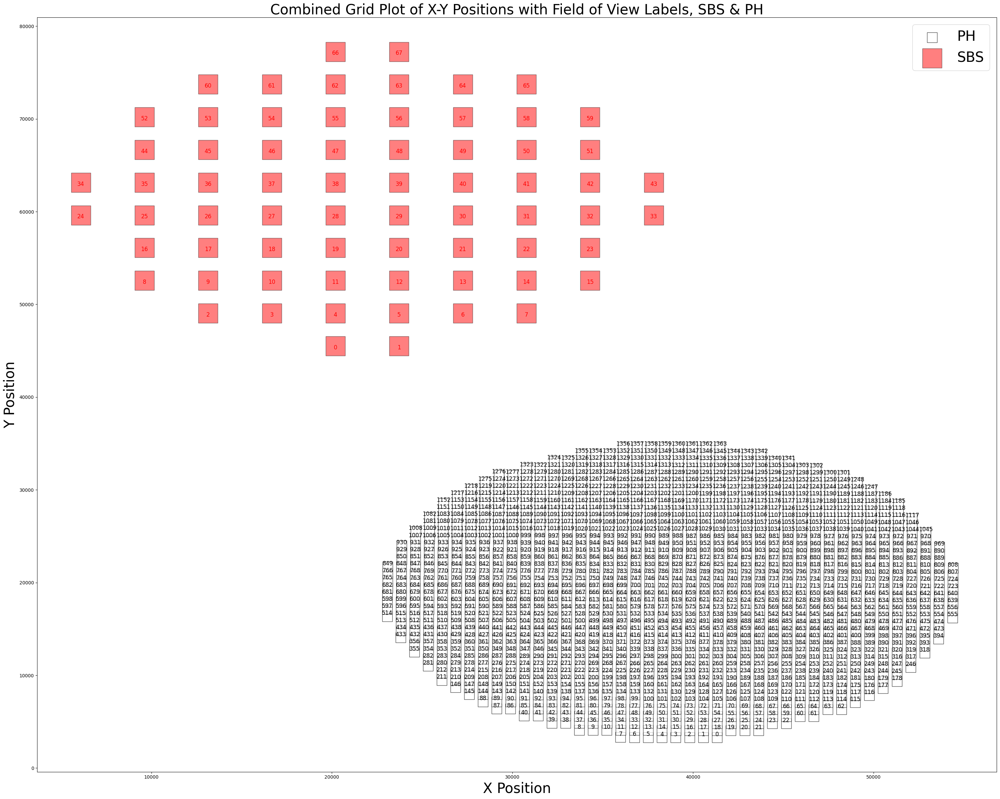

In [113]:
# Check the result with your combined tile grid
combined_tile_grid = plot_combined_tile_grid(ph_test_metadata, sbs_test_metadata)
combined_tile_grid.show()

In [114]:
ALIGNMENT_FLIP_X = True
ALIGNMENT_FLIP_Y = False
ALIGNMENT_ROTATE_90 = False
ALIGNMENT_REFERENCE_DF = 2

Original centers:
  Dataset 1: (21959.40, 61381.57)
  Dataset 2: (38735.04, 18960.91)

Transforming dataset 1 to match dataset 2
Step 1: Centered coordinates around (21959.40, 61381.57)
Step 2a: Flipped x coordinates
Step 4: Applied translation: (38735.04, 18960.91)

Final centers:
  Dataset 1: (38735.04, 18960.91)
  Dataset 2: (38735.04, 18960.91)


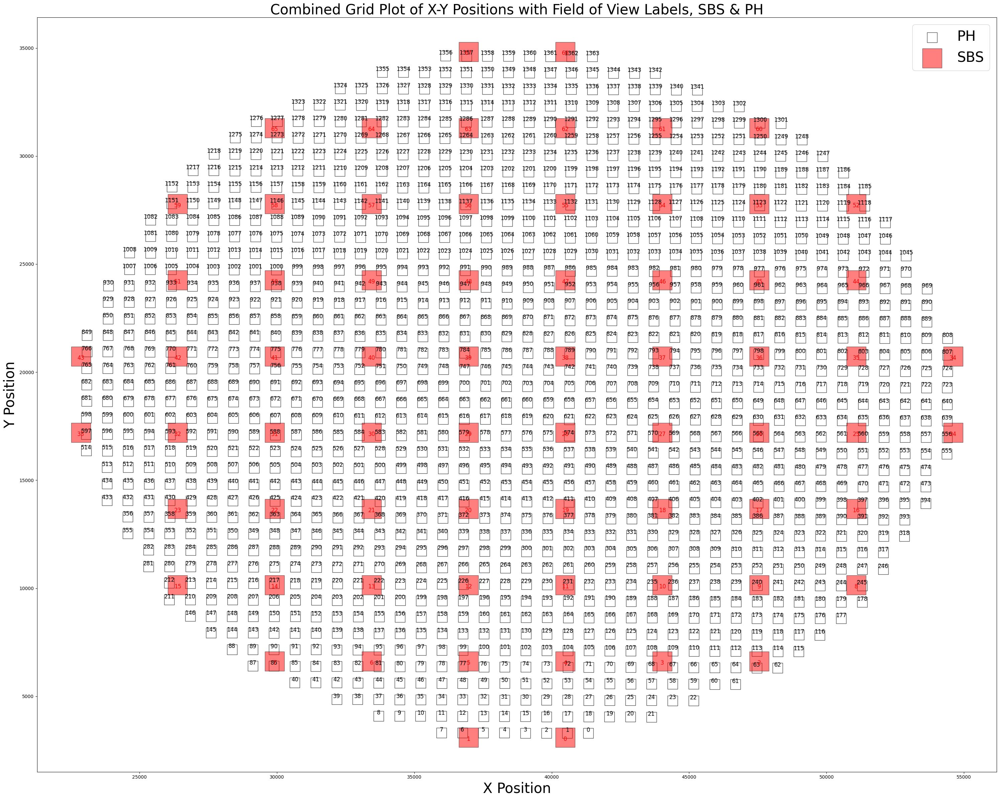

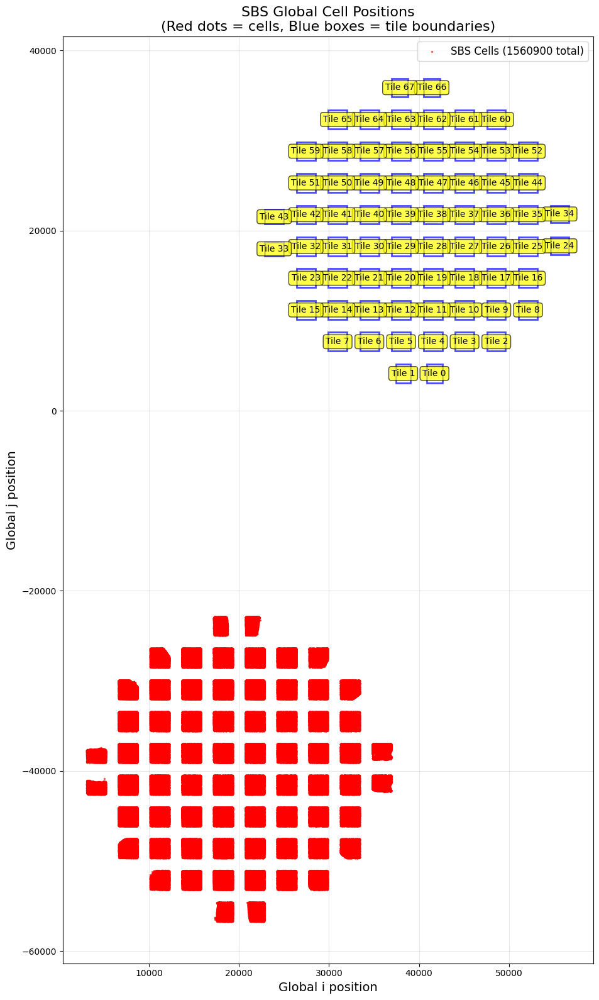

=== SBS GLOBAL POSITIONING SUMMARY ===
Total cells: 1560900
Total tiles: 68
Global coordinate range:
  i: 3096 to 36909
  j: -56683 to -22870


In [115]:
# Apply flip and rotate transformation
sbs_aligned, ph_aligned, transform_info = align_coordinates_flip_rotate(
    sbs_test_metadata, ph_test_metadata, 
    flip_x=ALIGNMENT_FLIP_X,     # Flip x coordinates (horizontal flip)
    flip_y=ALIGNMENT_FLIP_Y,    # Don't flip y coordinates
    rotate_90=ALIGNMENT_ROTATE_90,  # No rotation
    reference_df=ALIGNMENT_REFERENCE_DF,
)

# Check the result with your combined tile grid
combined_tile_grid = plot_combined_tile_grid(ph_aligned, sbs_aligned)
combined_tile_grid.show()

# Verify with the global cell positions
merged_data = plot_sbs_global_cell_positions(sbs_info, sbs_aligned)

## <font color='red'>SET PARAMETERS</font>

### Parameters for testing merge processing

- `INITIAL_SITES`: Combinations of phenotype and SBS tiles used for configuring merge module parameters. Based on the combined grid above, set 6 aligned intial sites. We will load images for one of those sites, to ensure that we can visualize cell patterns (using the DAPI channel) that correspond between two tiles that will make up our initial sites. We recommend using aligned sites from across the plate.

In [94]:
import pandas as pd
import numpy as np

def find_closest_tiles(sbs_metadata, ph_metadata, sbs_tile_id):
    """
    Find closest tiles in ph_metadata to a specific tile in sbs_metadata
    
    Args:
        sbs_metadata: DataFrame with x_pos, y_pos columns
        ph_metadata: DataFrame with x_pos, y_pos columns  
        sbs_tile_id: ID of sbs tile to find neighbors for
    
    Returns:
        DataFrame of ph tiles sorted by distance to sbs_tile_id
    """
    # Get sbs tile coordinates
    sbs_tile = sbs_metadata[sbs_metadata.tile == sbs_tile_id]
    sbs_x, sbs_y = sbs_tile['x_pos'].iloc[0], sbs_tile['y_pos'].iloc[0]
    
    # Calculate distances to all ph tiles
    distances = np.sqrt((ph_metadata['x_pos'] - sbs_x)**2 + (ph_metadata['y_pos'] - sbs_y)**2)
    
    # Return sorted results
    result = ph_metadata.copy()
    result['distance'] = distances

    # Print the top 3 closest tiles
    closest_tiles = result.nsmallest(3, 'distance')
    print(f"Top 3 closest tiles to SBS tile {sbs_tile_id}:")
    for idx, row in closest_tiles.iterrows():
        print(f"  Tile {row['tile']}: Distance = {row['distance']:.2f}, ")

    return result.sort_values('distance')

# Usage:
closest = find_closest_tiles(sbs_aligned, ph_aligned, 0)

closest = find_closest_tiles(sbs_aligned, ph_aligned, 11)

closest = find_closest_tiles(sbs_aligned, ph_aligned, 25)

closest = find_closest_tiles(sbs_aligned, ph_aligned, 49)

closest = find_closest_tiles(sbs_aligned, ph_aligned, 53)

closest = find_closest_tiles(sbs_aligned, ph_aligned, 67)


Top 3 closest tiles to SBS tile 0:
  Tile 1: Distance = 214.32, 
  Tile 2: Distance = 721.22, 
  Tile 0: Distance = 859.24, 
Top 3 closest tiles to SBS tile 11:
  Tile 231: Distance = 107.41, 
  Tile 230: Distance = 659.21, 
  Tile 192: Distance = 747.63, 
Top 3 closest tiles to SBS tile 25:
  Tile 560: Distance = 325.14, 
  Tile 561: Distance = 550.51, 
  Tile 635: Distance = 613.95, 
Top 3 closest tiles to SBS tile 49:
  Tile 943: Distance = 460.49, 
  Tile 942: Distance = 511.32, 
  Tile 995: Distance = 580.60, 
Top 3 closest tiles to SBS tile 53:
  Tile 1123: Distance = 73.76, 
  Tile 1180: Distance = 690.91, 
  Tile 1124: Distance = 757.94, 
Top 3 closest tiles to SBS tile 67:
  Tile 1357: Distance = 213.69, 
  Tile 1358: Distance = 721.21, 
  Tile 1356: Distance = 859.33, 


In [95]:
INITIAL_SITES = [[1, 0], [231, 11], [560, 25], [943, 49], [1123, 53], [1357, 67]]

In [96]:
# Derive sites for phenotype and sbs
phenotype_tiles = [site[0] for site in INITIAL_SITES]
sbs_tiles = [site[1] for site in INITIAL_SITES]

# Derive phenotype alignment hash
phenotype_info_fp = (
    ROOT_FP
    / "phenotype"
    / "parquets"
    / get_filename(
        {"plate": TEST_PLATE, "well": TEST_WELL}, "phenotype_info", "parquet"
    )
)
phenotype_info = pd.read_parquet(phenotype_info_fp)
phenotype_info_hash = hash_cell_locations(phenotype_info)

# Derive SBS alignment hash
sbs_info_fp = (
    ROOT_FP
    / "sbs"
    / "parquets"
    / get_filename({"plate": TEST_PLATE, "well": TEST_WELL}, "sbs_info", "parquet")
)
sbs_info = pd.read_parquet(sbs_info_fp)
sbs_info_hash = hash_cell_locations(sbs_info).rename(columns={"tile": "site"})

In [97]:
# Perform alignment for initial sites
initial_alignment_df = initial_alignment(
    phenotype_info_hash, sbs_info_hash, initial_sites=INITIAL_SITES
)
initial_alignment_df

,rotation,translation,score,determinant,site,tile
0,"[[0.319930793622772, 0.0030494737591151588], [...","[932.8866493651509, 575.1563546279785]",0.517089,0.102002,0,1
1,"[[0.319275166342926, 0.002599068103414565], [-...","[841.1553231095927, 559.9615676175848]",0.617989,0.101917,11,231
2,"[[0.31910127356847895, 0.002728050401394971], ...","[718.631444290909, 481.5571812997088]",0.554401,0.101828,25,560
3,"[[0.3191683590459844, 0.002702749560365369], [...","[675.3637179284996, 431.9822183738585]",0.630491,0.101932,49,943
4,"[[0.319130471220813, 0.002846755660497694], [-...","[791.0668369025751, 609.1180760441702]",0.606121,0.101883,53,1123
5,"[[0.31918383947183715, 0.0026869723284020713],...","[728.5073469363621, 653.8241509932951]",0.608064,0.101895,67,1357


## <font color='red'>SET PARAMETERS</font>

### Visualize gating strategy based on initial alignment

- `DET_RANGE`: Enforces valid magnification ratios between phenotype and genotype images.
  - The determinant range accounts for differences in:
    - Objective magnifications (e.g., 20X vs 10X)
    - Camera binning settings (e.g., 2x2 vs unbinned)
  - Calculation formula:
    - If magnification ratio = M and binning ratio = B
    - Total difference factor = M × B
    - `DET_RANGE` = [0.9/(M×B)², 1.15/(M×B)²]
  - Example:
    - With 2× magnification difference and 2× binning difference
    - Total difference factor = 2 × 2 = 4
    - `DET_RANGE` = [0.9/16, 1.15/16] = [0.056, 0.072]
  - Adjust range as needed for matching precision
- `SCORE`: This parameter is the score of the transformation, typically 0.1

In [109]:
DET_RANGE = [0.09, 0.12]
SCORE = 0.1

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Alignment Quality Check\nScore vs Determinant'}, xlabel='Determinant', ylabel='Score'>)

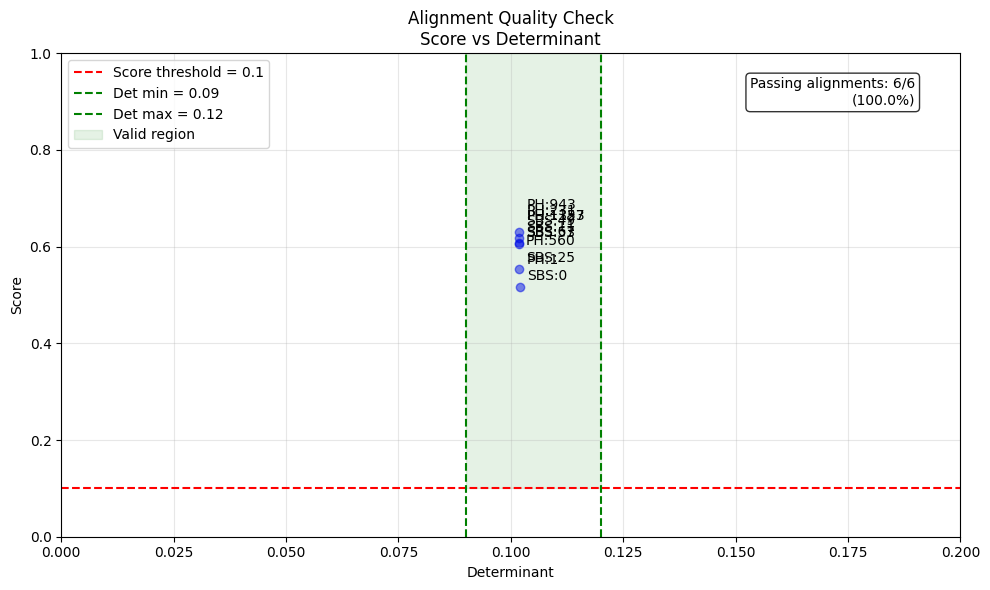

In [111]:
plot_alignment_quality(
    initial_alignment_df, det_range=DET_RANGE, score=SCORE, xlim=(0, 0.2), ylim=(0, 1)
)

## <font color='red'>SET PARAMETERS</font>

### Visualize cell matches based on initial alignment

- `THRESHOLD`: Determines the maximum euclidean distance between a phenotype point and its matched SBS point for them to be considered a valid match

In [105]:
THRESHOLD = 10

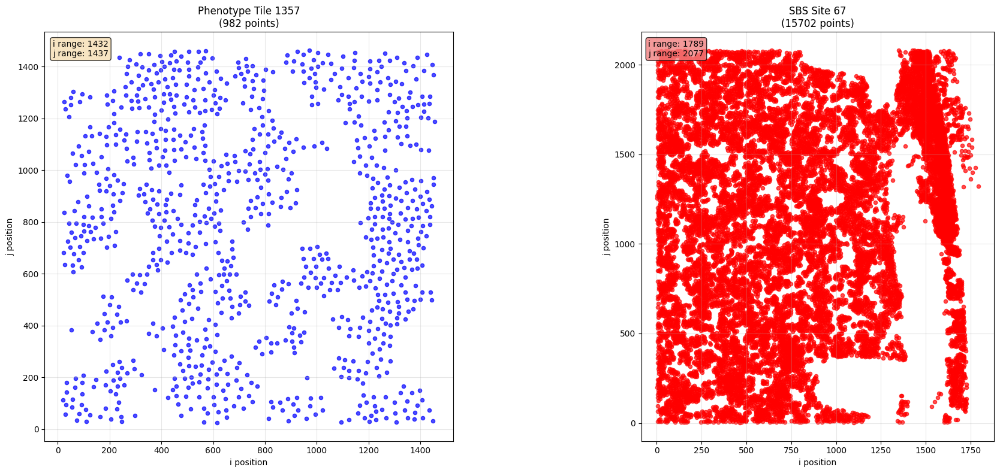

=== TILE COMPARISON ===
Phenotype Tile 1357: 982 points
SBS Site 67: 15702 points

Coordinate ranges:
PH - i: 21 to 1454 (range: 1432)
PH - j: 25 to 1463 (range: 1437)
SBS - i: 3 to 1792 (range: 1789)
SBS - j: 3 to 2080 (range: 2077)

Point density comparison:
PH density: 0.0005 points per unit area
SBS density: 0.0042 points per unit area


In [106]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_simple_tile_comparison(df_ph, df_sbs, ph_tile, sbs_site):
    """
    Simple side-by-side comparison of i,j positions for a phenotype tile and SBS site.
    No matching or alignment attempted - just raw coordinate visualization.
    
    Args:
        df_ph (pandas.DataFrame): Phenotype data with 'i', 'j', 'tile' columns.
        df_sbs (pandas.DataFrame): SBS data with 'i', 'j', 'tile' columns.
        ph_tile (int): Phenotype tile ID to plot
        sbs_site (int): SBS site/tile ID to plot
    """
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
    
    # Filter for specific tile and site
    df_ph_filtered = df_ph[df_ph["tile"] == ph_tile]
    df_sbs_filtered = df_sbs[df_sbs["tile"] == sbs_site]
    
    # Get coordinates
    ph_coords = df_ph_filtered[["i", "j"]].values
    sbs_coords = df_sbs_filtered[["i", "j"]].values
    
    # Plot 1: Phenotype tile
    ax1.scatter(ph_coords[:, 0], ph_coords[:, 1], c="blue", s=20, alpha=0.7)
    ax1.set_title(f"Phenotype Tile {ph_tile}\n({len(ph_coords)} points)")
    ax1.set_xlabel("i position")
    ax1.set_ylabel("j position")
    ax1.grid(True, alpha=0.3)
    ax1.set_aspect('equal')
    
    # Add some basic stats
    if len(ph_coords) > 0:
        ph_i_range = ph_coords[:, 0].max() - ph_coords[:, 0].min()
        ph_j_range = ph_coords[:, 1].max() - ph_coords[:, 1].min()
        ax1.text(0.02, 0.98, f"i range: {ph_i_range:.0f}\nj range: {ph_j_range:.0f}", 
                transform=ax1.transAxes, verticalalignment='top',
                bbox=dict(boxstyle="round", facecolor='wheat', alpha=0.8))
    
    # Plot 2: SBS site
    ax2.scatter(sbs_coords[:, 0], sbs_coords[:, 1], c="red", s=20, alpha=0.7)
    ax2.set_title(f"SBS Site {sbs_site}\n({len(sbs_coords)} points)")
    ax2.set_xlabel("i position")
    ax2.set_ylabel("j position")
    ax2.grid(True, alpha=0.3)
    ax2.set_aspect('equal')
    
    # Add some basic stats
    if len(sbs_coords) > 0:
        sbs_i_range = sbs_coords[:, 0].max() - sbs_coords[:, 0].min()
        sbs_j_range = sbs_coords[:, 1].max() - sbs_coords[:, 1].min()
        ax2.text(0.02, 0.98, f"i range: {sbs_i_range:.0f}\nj range: {sbs_j_range:.0f}", 
                transform=ax2.transAxes, verticalalignment='top',
                bbox=dict(boxstyle="round", facecolor='lightcoral', alpha=0.8))
    
    plt.tight_layout()
    plt.show()
    
    # Print some comparison stats
    print(f"=== TILE COMPARISON ===")
    print(f"Phenotype Tile {ph_tile}: {len(ph_coords)} points")
    print(f"SBS Site {sbs_site}: {len(sbs_coords)} points")
    
    if len(ph_coords) > 0 and len(sbs_coords) > 0:
        print(f"\nCoordinate ranges:")
        print(f"PH - i: {ph_coords[:, 0].min():.0f} to {ph_coords[:, 0].max():.0f} (range: {ph_i_range:.0f})")
        print(f"PH - j: {ph_coords[:, 1].min():.0f} to {ph_coords[:, 1].max():.0f} (range: {ph_j_range:.0f})")
        print(f"SBS - i: {sbs_coords[:, 0].min():.0f} to {sbs_coords[:, 0].max():.0f} (range: {sbs_i_range:.0f})")
        print(f"SBS - j: {sbs_coords[:, 1].min():.0f} to {sbs_coords[:, 1].max():.0f} (range: {sbs_j_range:.0f})")
        
        print(f"\nPoint density comparison:")
        ph_area = ph_i_range * ph_j_range if ph_i_range > 0 and ph_j_range > 0 else 1
        sbs_area = sbs_i_range * sbs_j_range if sbs_i_range > 0 and sbs_j_range > 0 else 1
        print(f"PH density: {len(ph_coords)/ph_area:.4f} points per unit area")
        print(f"SBS density: {len(sbs_coords)/sbs_area:.4f} points per unit area")

alignment_vec_example = initial_alignment_df[
    (initial_alignment_df["tile"] == INITIAL_SITES[2][0])
    & (initial_alignment_df["site"] == INITIAL_SITES[2][1])
].iloc[0]

# Extract the tile and site from your alignment vector
ph_tile = alignment_vec_example["tile"]
sbs_site = alignment_vec_example["site"]

# Plot the comparison
plot_simple_tile_comparison(phenotype_info, sbs_info, 1357, 67)

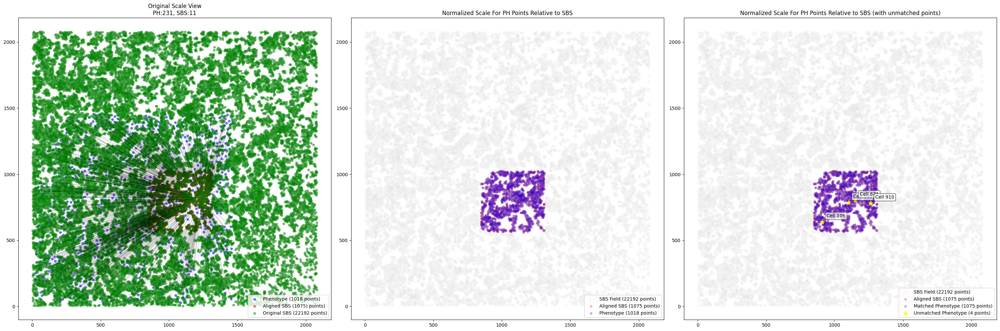

In [107]:
alignment_vec_example = initial_alignment_df[
    (initial_alignment_df["tile"] == INITIAL_SITES[1][0])
    & (initial_alignment_df["site"] == INITIAL_SITES[1][1])
].iloc[0]

plot_merge_example(
    phenotype_info,
    sbs_info,
    alignment_vec_example,
    threshold=THRESHOLD,
)


--- Merging Tile 1 with Site 0 ---


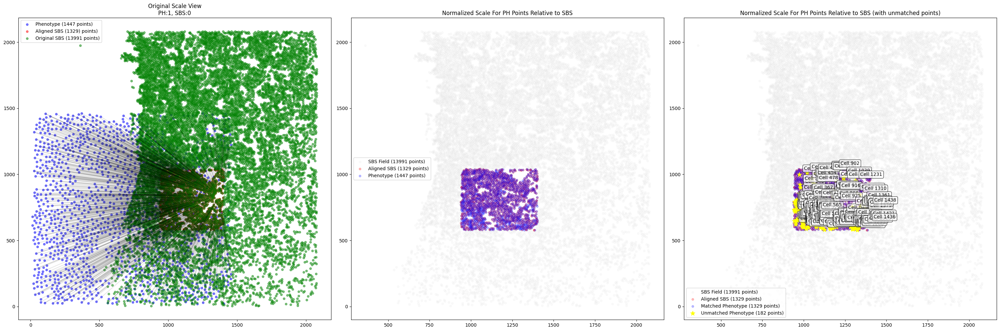


--- Merging Tile 231 with Site 11 ---


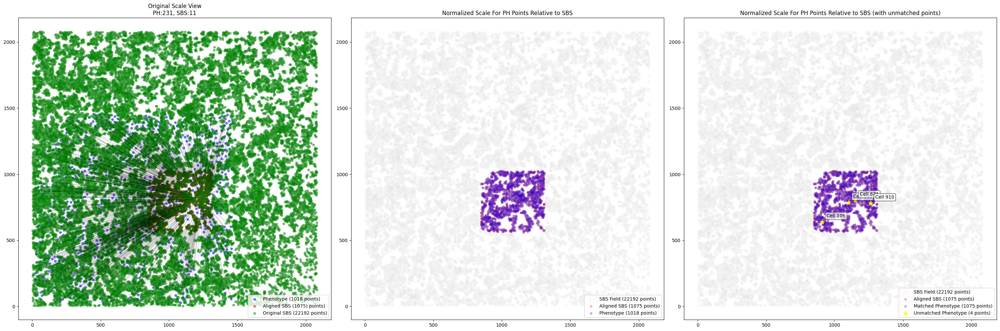


--- Merging Tile 560 with Site 25 ---


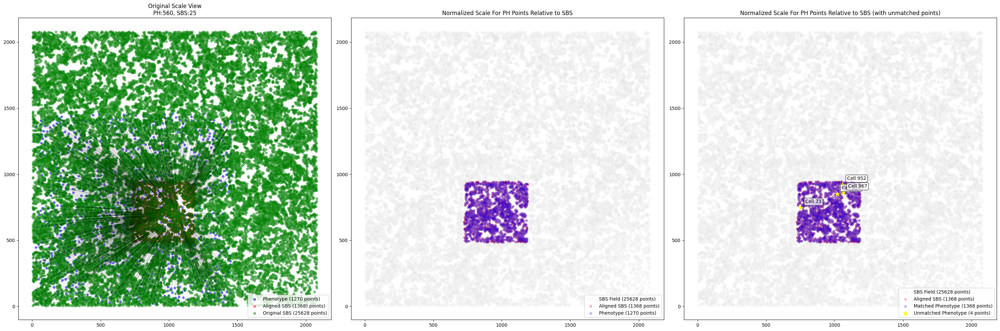


--- Merging Tile 943 with Site 49 ---


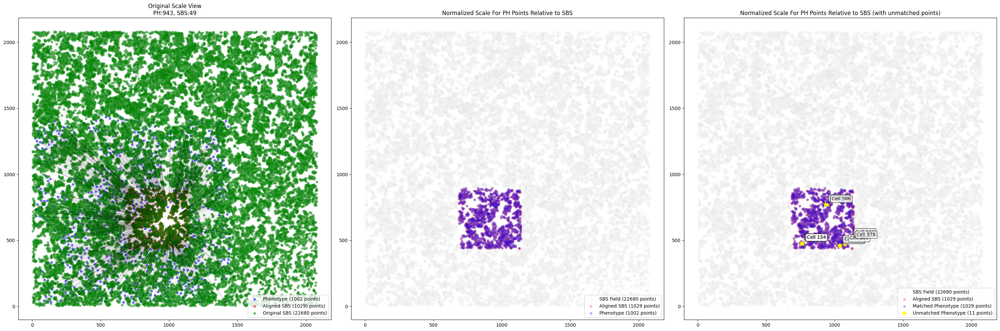


--- Merging Tile 1123 with Site 53 ---


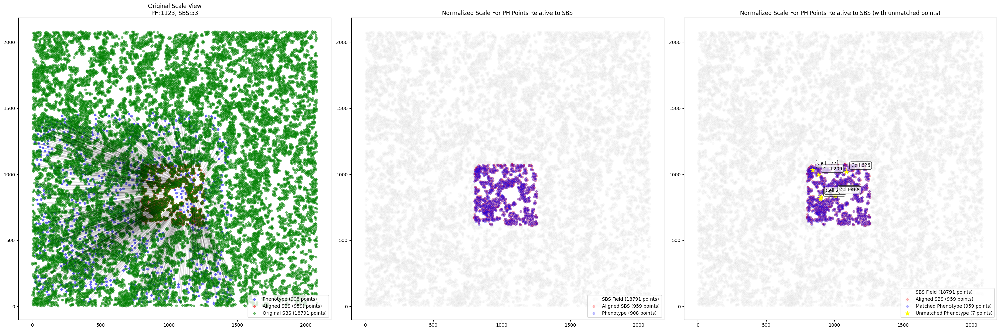


--- Merging Tile 1357 with Site 67 ---


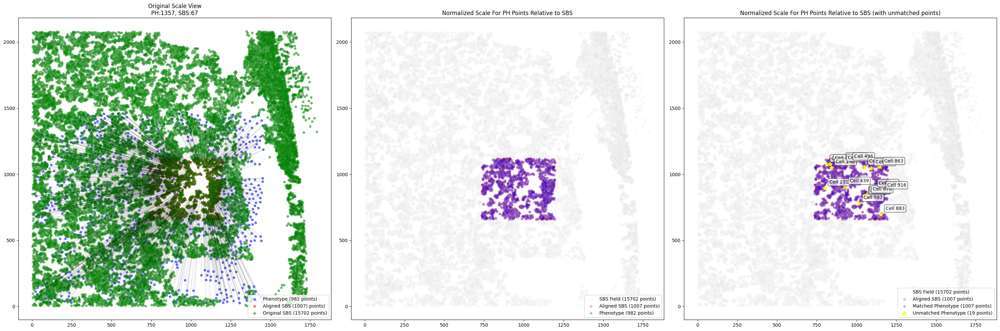

In [108]:
for i in range(len(INITIAL_SITES)):
    alignment_vec_example = initial_alignment_df[
        (initial_alignment_df["tile"] == INITIAL_SITES[i][0])
        & (initial_alignment_df["site"] == INITIAL_SITES[i][1])
    ].iloc[0]
    
    print(f"\n--- Merging Tile {alignment_vec_example['tile']} with Site {alignment_vec_example['site']} ---")
    plot_merge_example(
        phenotype_info,
        sbs_info,
        alignment_vec_example,
        threshold=THRESHOLD,
    )

In [ ]:
from scipy.spatial.distance import cdist

from lib.merge.merge import build_linear_model

def plot_diagnostic_merge(df_ph, df_sbs, alignment_vec, threshold=2, padding=50):
    """Creates a high-DPI diagnostic plot zoomed around phenotype points for alignment troubleshooting.
    
    Args:
        df_ph (pandas.DataFrame): Phenotype data with 'i', 'j' columns.
        df_sbs (pandas.DataFrame): SBS data with 'i', 'j' columns.
        alignment_vec (dict): Contains 'rotation' and 'translation' for alignment.
        threshold (float, optional): Distance threshold for matching points. Defaults to 2.
        padding (int, optional): Extra space around phenotype points. Defaults to 50.
    
    Returns:
        matplotlib.figure.Figure: High-DPI figure for diagnostic viewing.
    """
    # Filter for specific tile and site
    df_ph_filtered = df_ph[df_ph["tile"] == alignment_vec["tile"]]
    df_sbs_filtered = df_sbs[df_sbs["tile"] == alignment_vec["site"]]

    # Get coordinates
    X = df_ph_filtered[["i", "j"]].values
    Y = df_sbs_filtered[["i", "j"]].values

    # Build model and predict
    model = build_linear_model(alignment_vec["rotation"], alignment_vec["translation"])
    Y_pred = model.predict(X)

    # Calculate distances and matches
    distances = cdist(Y, Y_pred, metric="sqeuclidean")
    ix = distances.argmin(axis=1)
    filt = np.sqrt(distances.min(axis=1)) < threshold

    # Filter aligned points
    Y_pred = Y_pred[ix[filt]]

    # Scale phenotype points to SBS coordinate system
    X_norm = (X - X.min(axis=0)) / (X.max(axis=0) - X.min(axis=0))
    Y_pred_range = Y_pred.max(axis=0) - Y_pred.min(axis=0)
    Y_pred_min = Y_pred.min(axis=0)
    X_scaled = (X_norm * Y_pred_range) + Y_pred_min

    # Find unmatched phenotype points
    matched_ph_ix = np.unique(ix[filt])
    unmatched_ph_mask = ~np.isin(np.arange(len(X)), matched_ph_ix)

    # Calculate zoom bounds around phenotype points
    x_min, x_max = X_scaled[:, 0].min() - padding, X_scaled[:, 0].max() + padding
    y_min, y_max = X_scaled[:, 1].min() - padding, X_scaled[:, 1].max() + padding

    # Create high-DPI figure
    fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=150)

    # Plot SBS field points (only those in zoom area)
    sbs_in_view = (Y[:, 0] >= x_min) & (Y[:, 0] <= x_max) & (Y[:, 1] >= y_min) & (Y[:, 1] <= y_max)
    ax.scatter(
        Y[sbs_in_view, 0],
        Y[sbs_in_view, 1],
        c="lightgray",
        s=15,
        alpha=0.3,
    )

    # Plot aligned SBS points
    ax.scatter(
        Y_pred[:, 0],
        Y_pred[:, 1],
        c="red",
        s=25,
        alpha=0.7,
    )

    # Plot matched phenotype points
    ax.scatter(
        X_scaled[~unmatched_ph_mask][:, 0],
        X_scaled[~unmatched_ph_mask][:, 1],
        c="blue",
        s=25,
        alpha=0.7,
    )

    # Plot unmatched phenotype points
    ax.scatter(
        X_scaled[unmatched_ph_mask][:, 0],
        X_scaled[unmatched_ph_mask][:, 1],
        marker="o",
        facecolors="none",
        edgecolors="yellow",
        s=80,
        alpha=0.7,
        linewidths=2,
    )

    # Set zoom limits
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)

    # Clean styling
    ax.set_aspect('equal')
    ax.grid(True, alpha=0.3)
    
    # Simple title without labels
    n_matched = len(Y_pred)
    n_unmatched = sum(unmatched_ph_mask)
    ax.set_title(f"Diagnostic View: {n_matched} matched, {n_unmatched} unmatched")

    plt.tight_layout()
    
    return fig


--- Merging Tile 1 with Site 0 ---

--- Merging Tile 231 with Site 11 ---

--- Merging Tile 560 with Site 25 ---

--- Merging Tile 943 with Site 49 ---

--- Merging Tile 1123 with Site 53 ---

--- Merging Tile 1357 with Site 67 ---


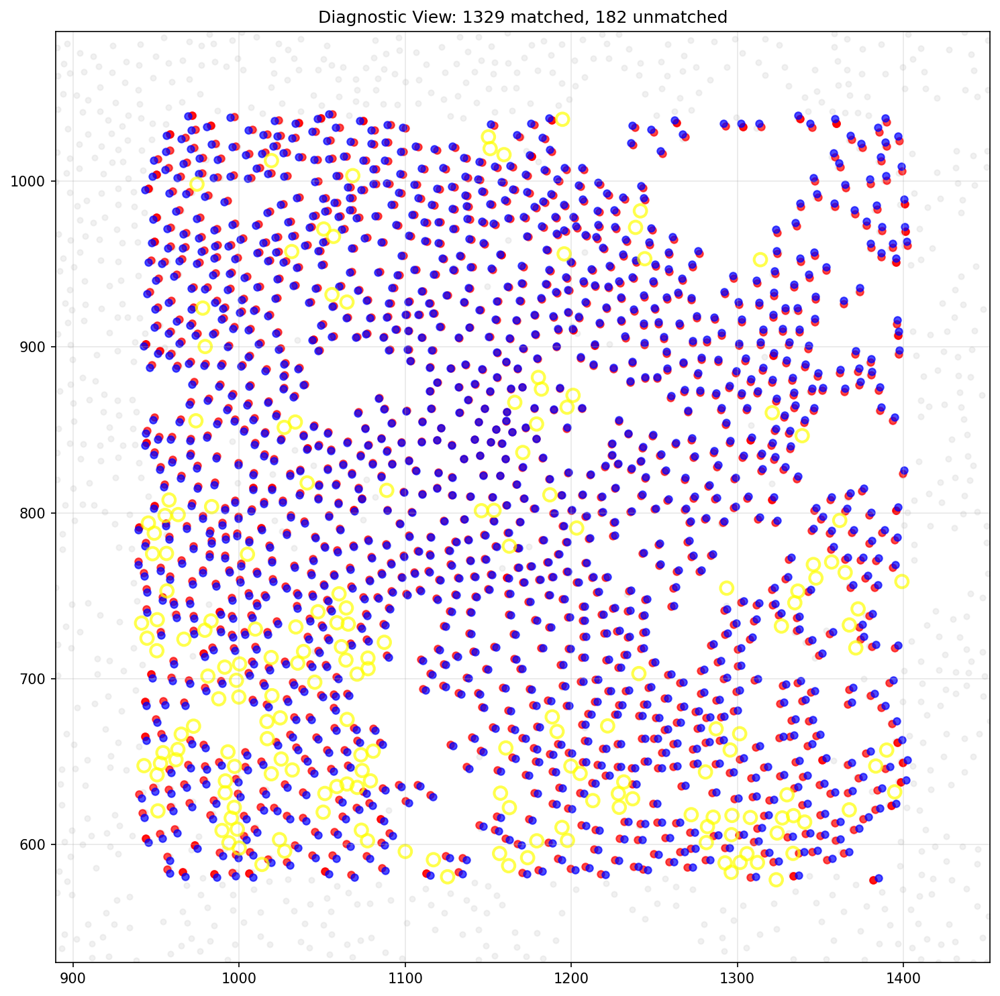

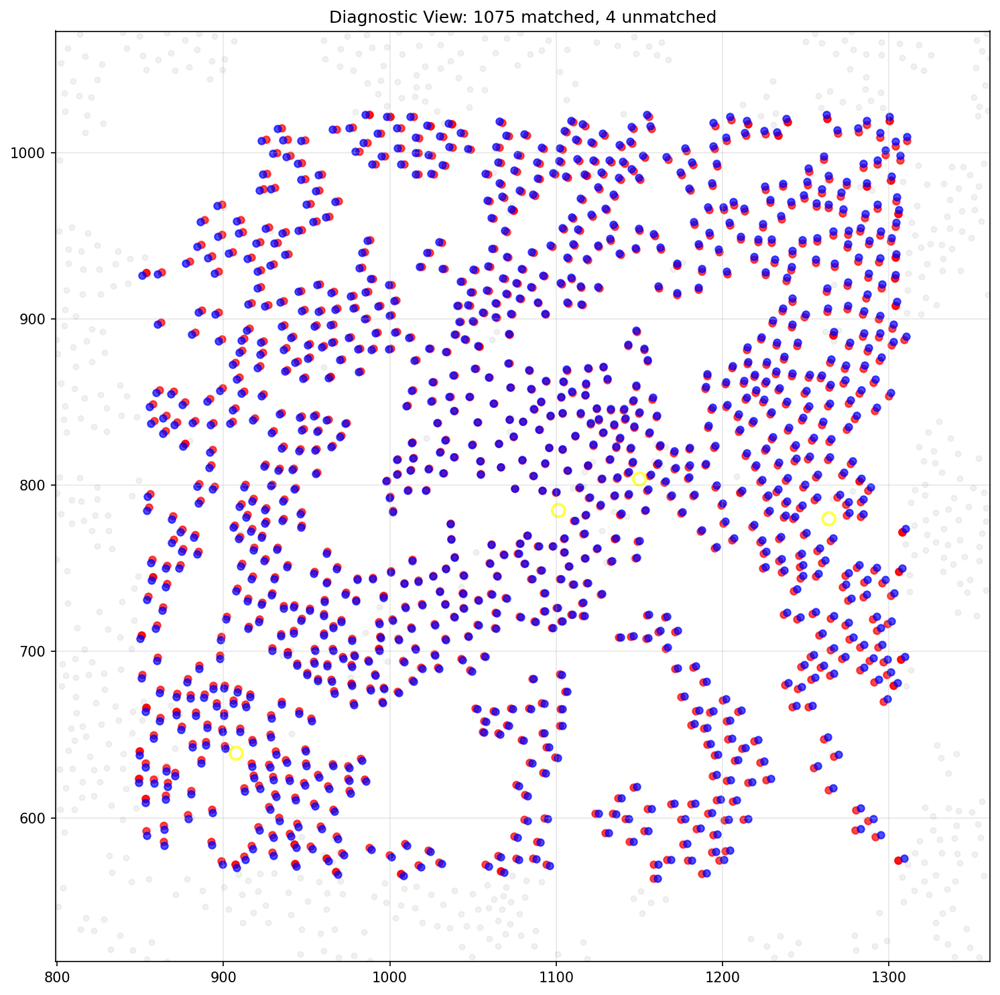

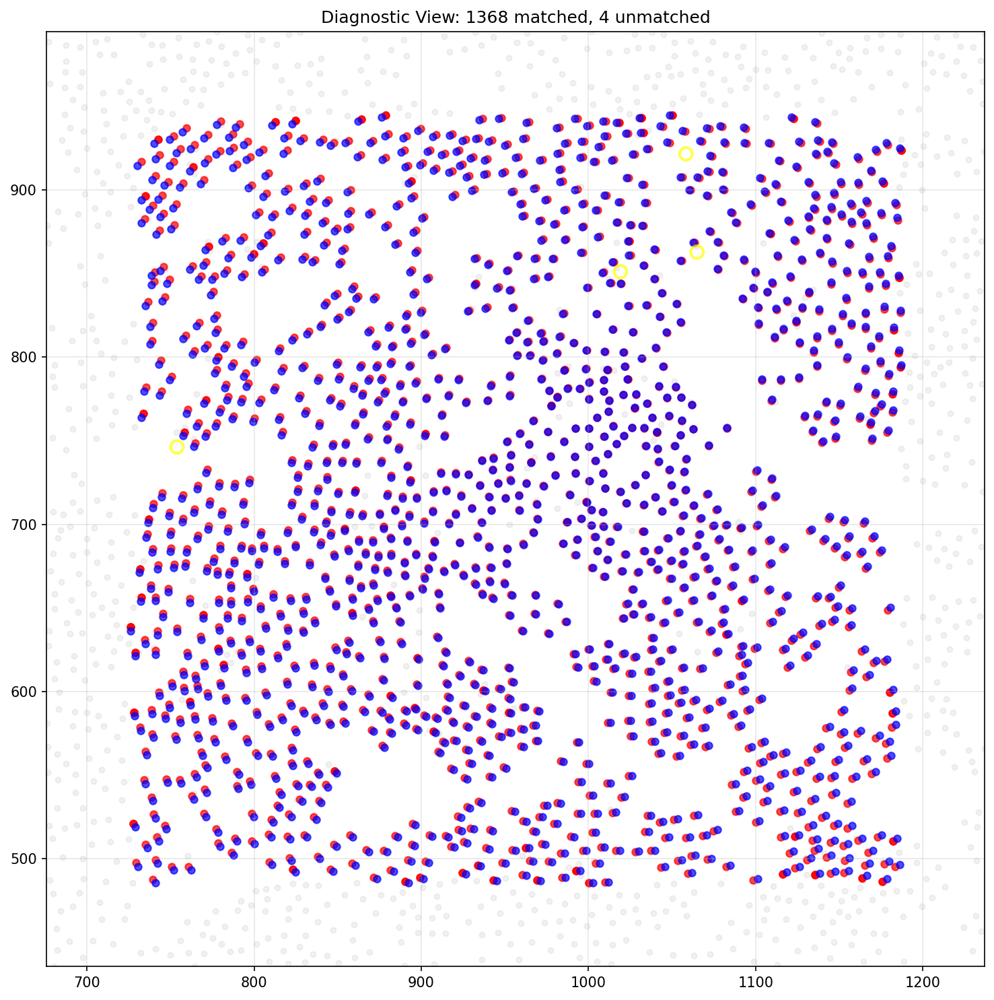

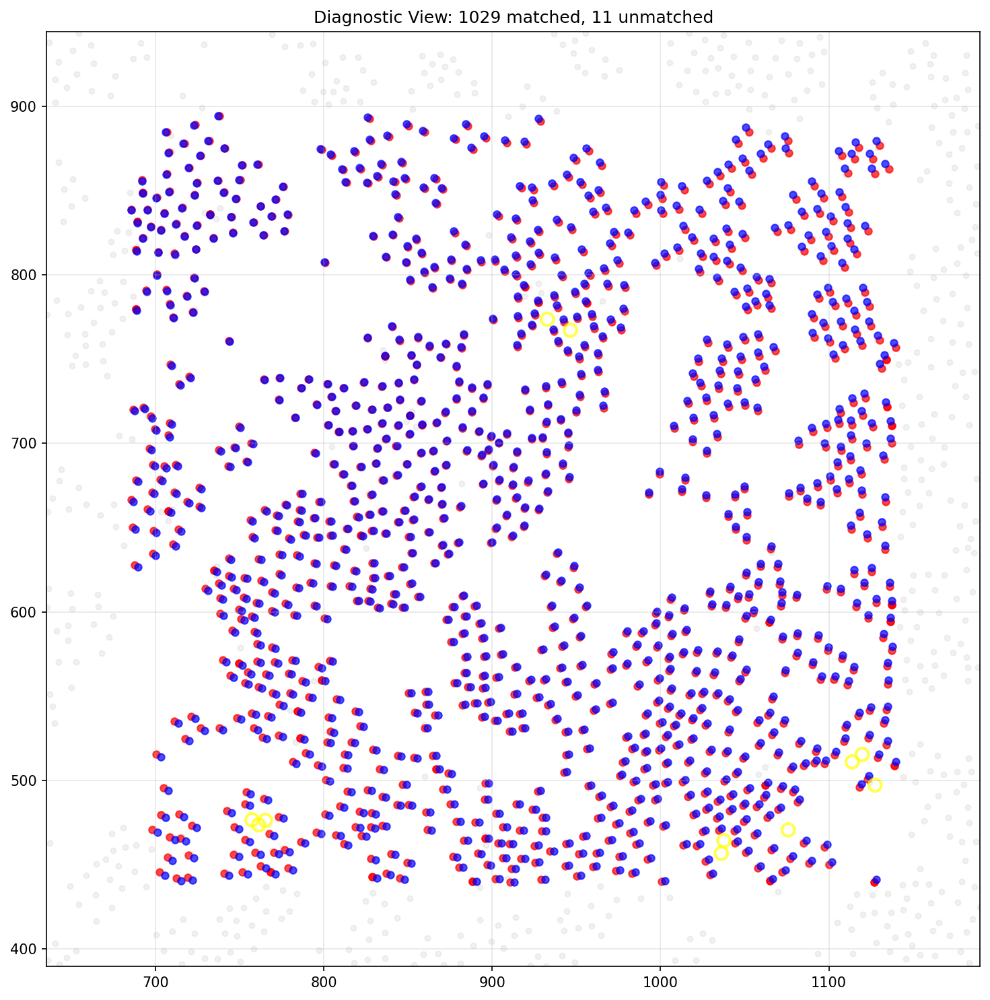

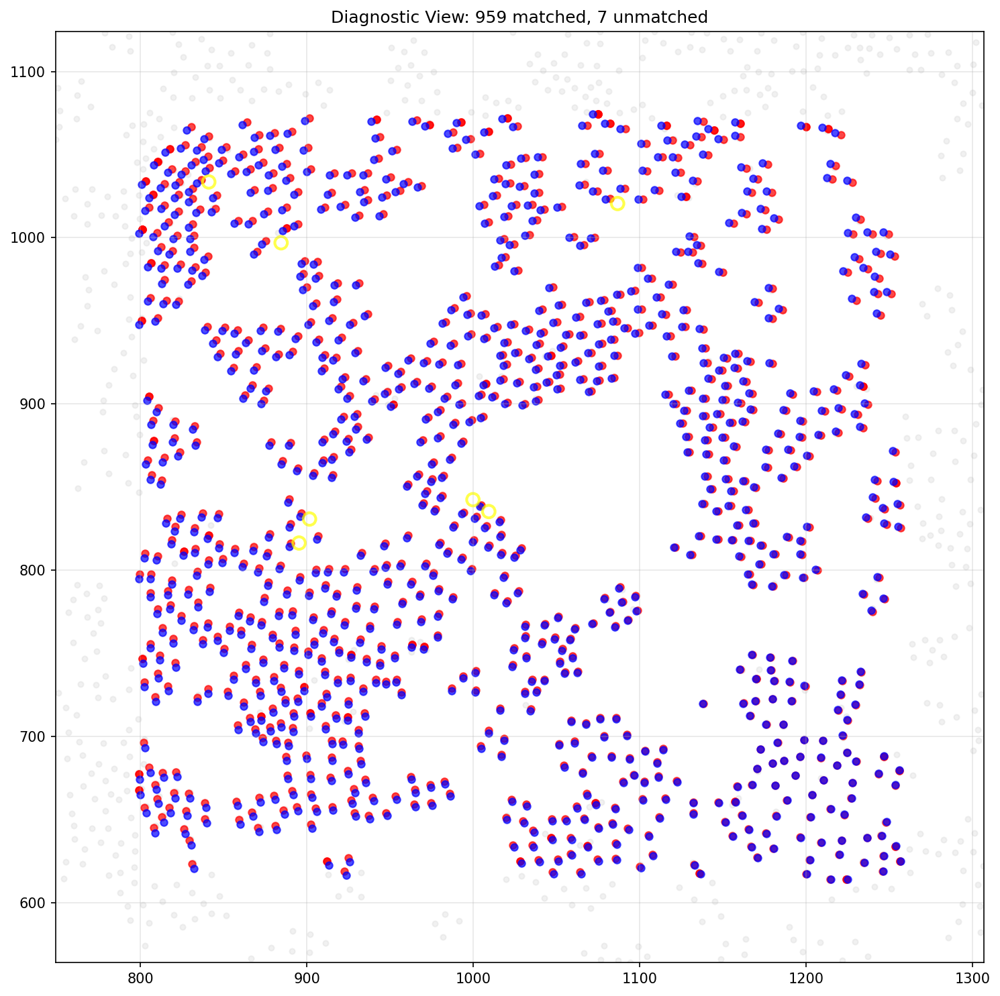

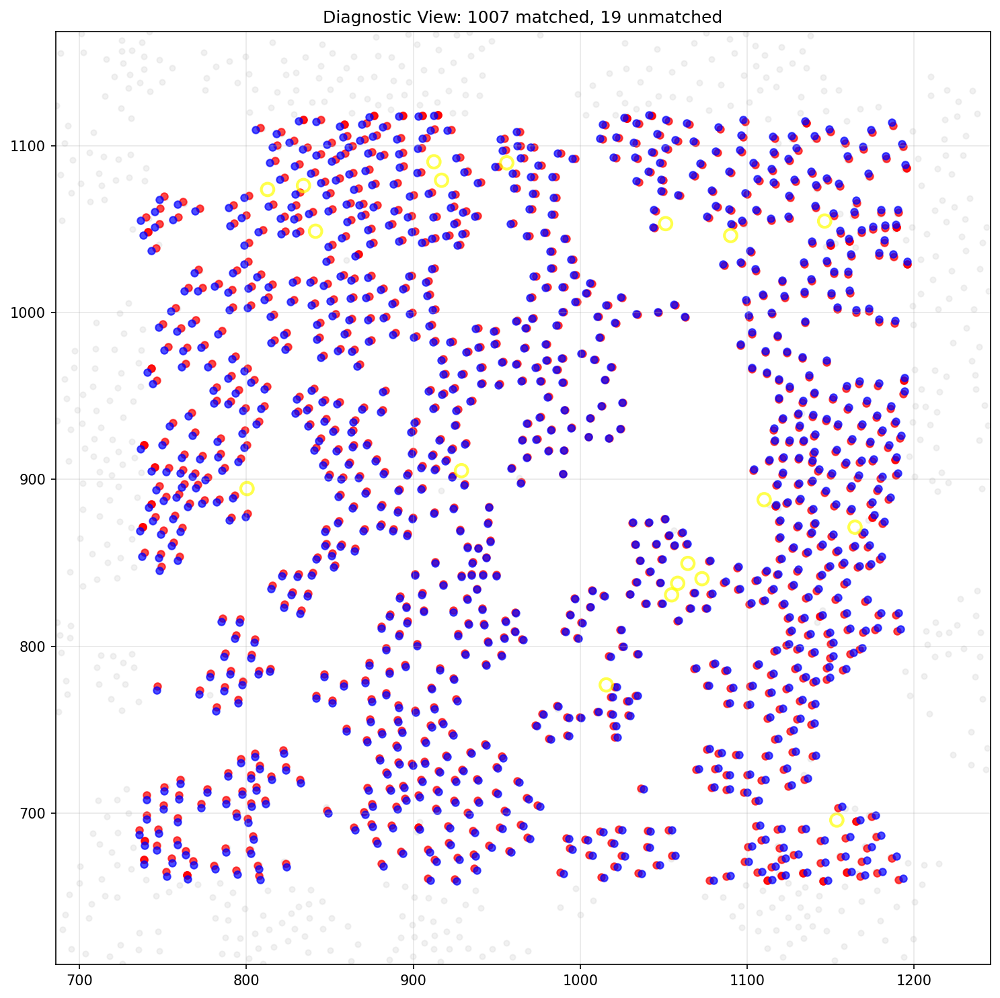

In [112]:
for i in range(len(INITIAL_SITES)):
    alignment_vec_example = initial_alignment_df[
        (initial_alignment_df["tile"] == INITIAL_SITES[i][0])
        & (initial_alignment_df["site"] == INITIAL_SITES[i][1])
    ].iloc[0]
    
    print(f"\n--- Merging Tile {alignment_vec_example['tile']} with Site {alignment_vec_example['site']} ---")
    plot_diagnostic_merge(
        phenotype_info,
        sbs_info,
        alignment_vec_example,
        threshold=THRESHOLD,
    )

## Add merge parameters to config file

In [116]:
# Add merge section
config["merge"] = {
    "merge_combo_fp": MERGE_COMBO_DF_FP,
    "sbs_metadata_cycle": SBS_METADATA_CYCLE,
    "sbs_metadata_channel": SBS_METADATA_CHANNEL,
    "ph_metadata_channel": PH_METADATA_CHANNEL,
    "alignment_flip_x": ALIGNMENT_FLIP_X,
    "alignment_flip_y": ALIGNMENT_FLIP_Y,
    "alignment_rotate_90": ALIGNMENT_ROTATE_90,
    "alignment_reference_df": ALIGNMENT_REFERENCE_DF,
    "initial_sites": INITIAL_SITES,
    "det_range": DET_RANGE,
    "score": SCORE,
    "threshold": THRESHOLD,
}

# Write the updated configuration back with markdown-style comments
with open(CONFIG_FILE_PATH, "w") as config_file:
    # Write the introductory markdown-stylåe comments
    config_file.write(CONFIG_FILE_HEADER)

    # Dump the updated YAML structure, keeping markdown comments for sections
    yaml.dump(config, config_file, default_flow_style=False, sort_keys=False)